# 🌸🌸🌸ぼかしてから、色情報で絞り込み！🌸🌸🌸

In [1]:
import numpy as np
import cv2
from matplotlib import pyplot as plt
%matplotlib inline

### 🐍Jupyter上でインライン表示するための関数を定義
- 以降、こいつに画像データを渡せばインライン表示してくれる！
- 読みやすくするためだけの関数

In [2]:
from IPython.display import display, Image

def display_cv_image(image, format='.png'):
    decoded_bytes = cv2.imencode(format, image)[1].tobytes()
    display(Image(data=decoded_bytes))

  
---
### 🐍まず原画像の確認

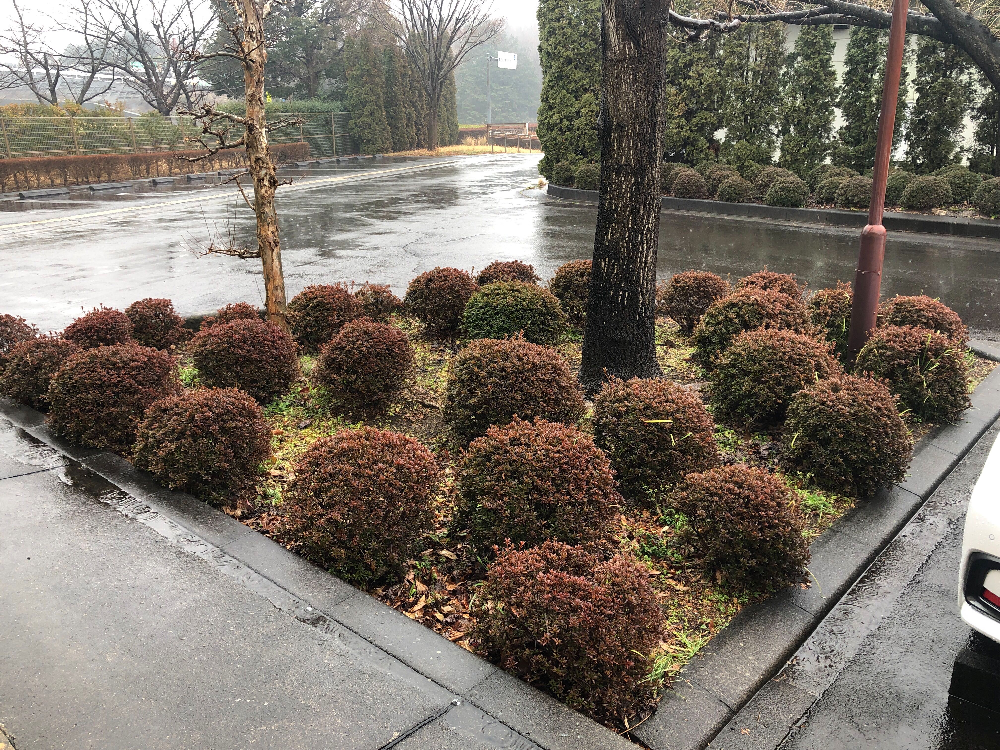

In [3]:
img = cv2.imread('resource/LumpofLeaves.png')
display_cv_image(img)

## 🎉ぼかす🎉
- Blurする関数はいくつかあるので、詳細はReadme.mdに記載しておいたで。
    - blur1 : Averaging(平均化・平滑化)
    - blur2 : Gaussian Blurring(ガウシアンフィルタ)
    - blur3 : Median Blurring(中央値ぼかし)
    - blur4 : Bilateral Filtering(エッジ残したままぼかす)

In [4]:
blur1 = cv2.blur(img,(15,15))
blur2 = cv2.GaussianBlur(img,(15,15),0)
blur3 = cv2.medianBlur(img,15)
blur4 = cv2.bilateralFilter(img,9,75,75)

blurs = [blur1, blur2, blur3, blur4]

### 🐍ぼかされた画像を表示したいところだけど、100Mb超えるので勘弁

In [5]:
# for blur in blurs:
#     display_cv_image(blur)

  
---
### 🐍ぼかされた画像4つをHSV変換して、前回と同じようにピクセルを絞り込む
- HSV変換して、ピクセル値で絞り込む処理を関数(select_pixels)にまとめてしまった。

In [6]:
def select_pixels(img):
    img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    ret_h, img_h = cv2.threshold(img_hsv[:,:,0],22,255,cv2.THRESH_BINARY_INV)
    ret_s, img_s = cv2.threshold(img_hsv[:,:,1],30,255,cv2.THRESH_BINARY )
    ret_v, img_v = cv2.threshold(img_hsv[:,:,2],100,255,cv2.THRESH_BINARY_INV)

    dst = cv2.bitwise_and(img_h, img_s, mask=img_v)
    return dst

In [7]:
dsts = [select_pixels(blur) for blur in blurs]

### 🐍絞り込まれたピクセルを表示

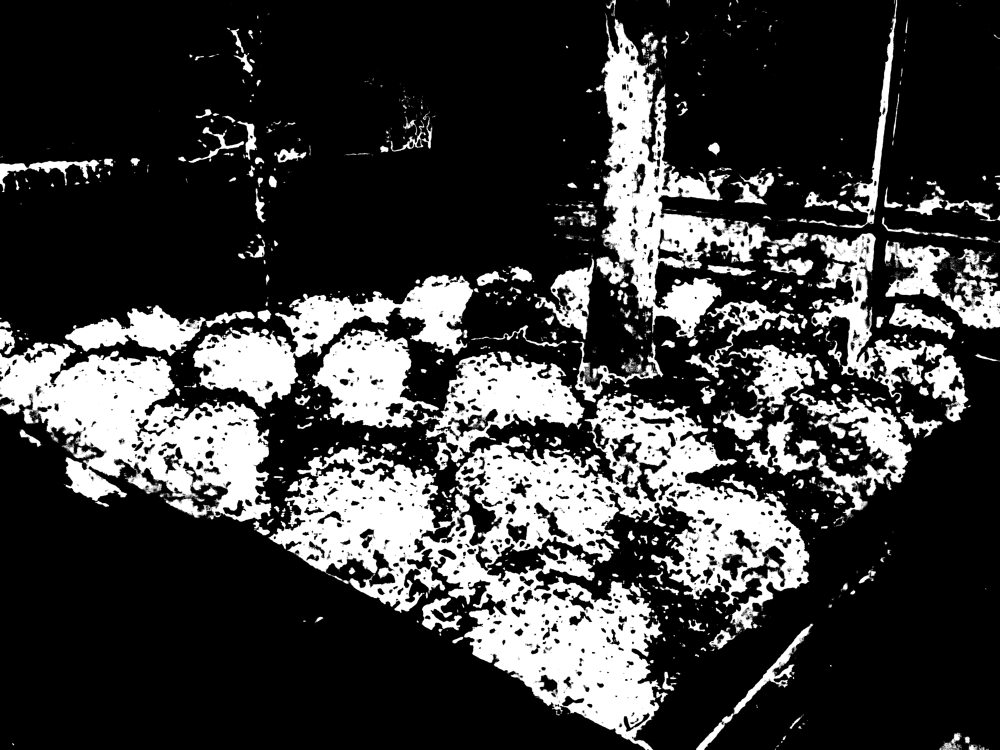

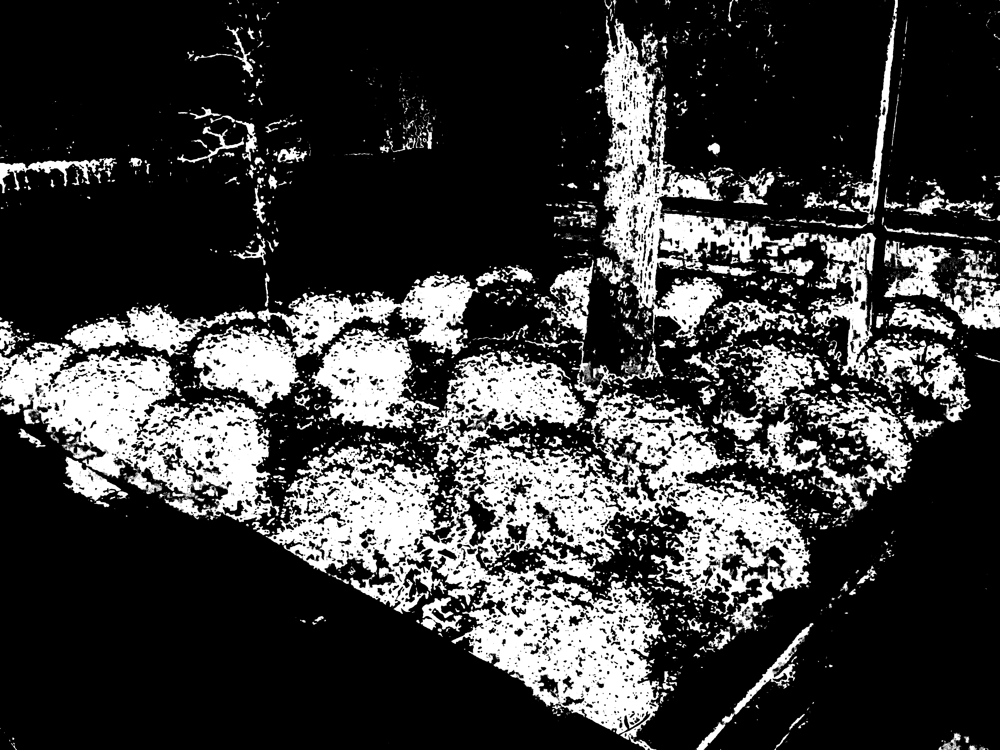

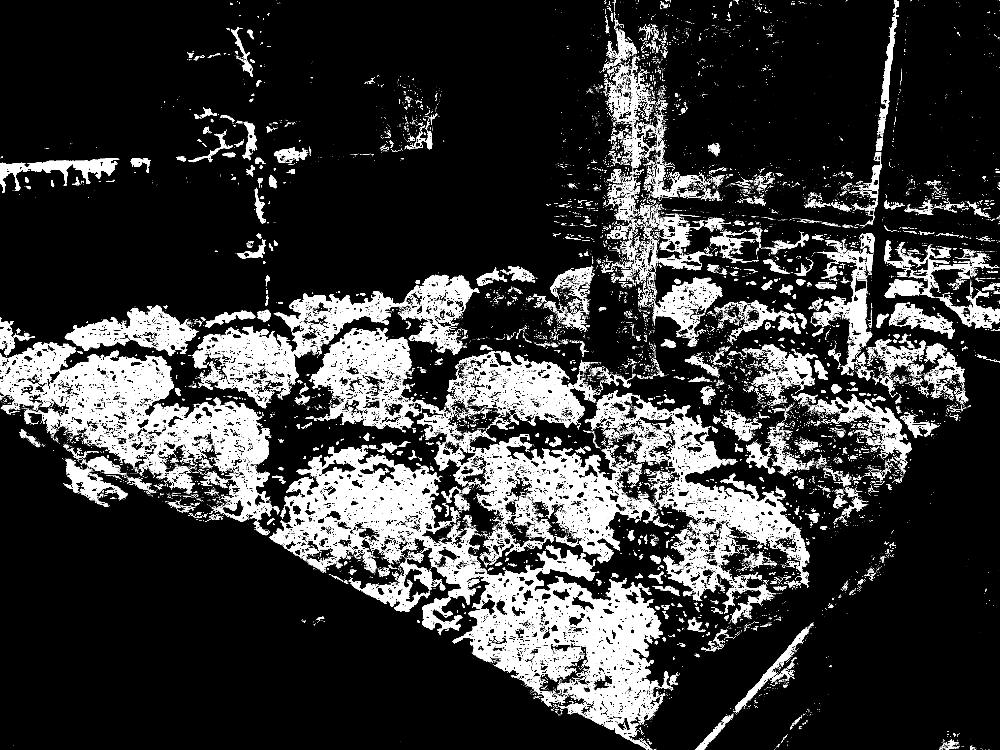

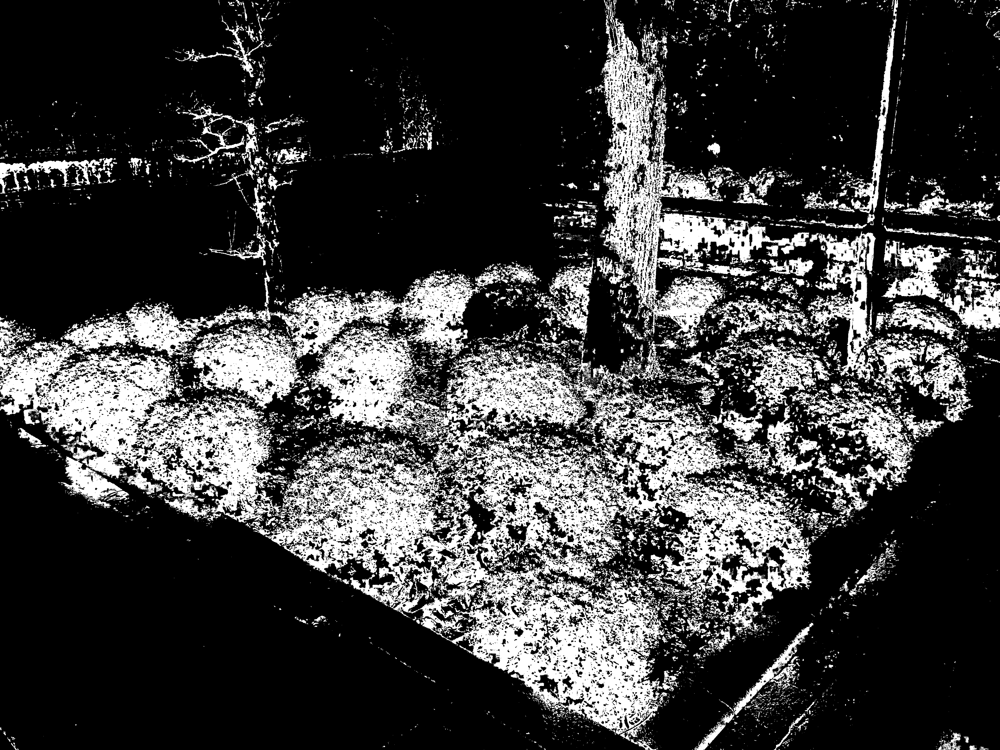

In [8]:
for dst in dsts:
    display_cv_image(dst)

### 🐍ちなみにぼかしてない画像で抽出したものがこちら
- なるほど…となる。

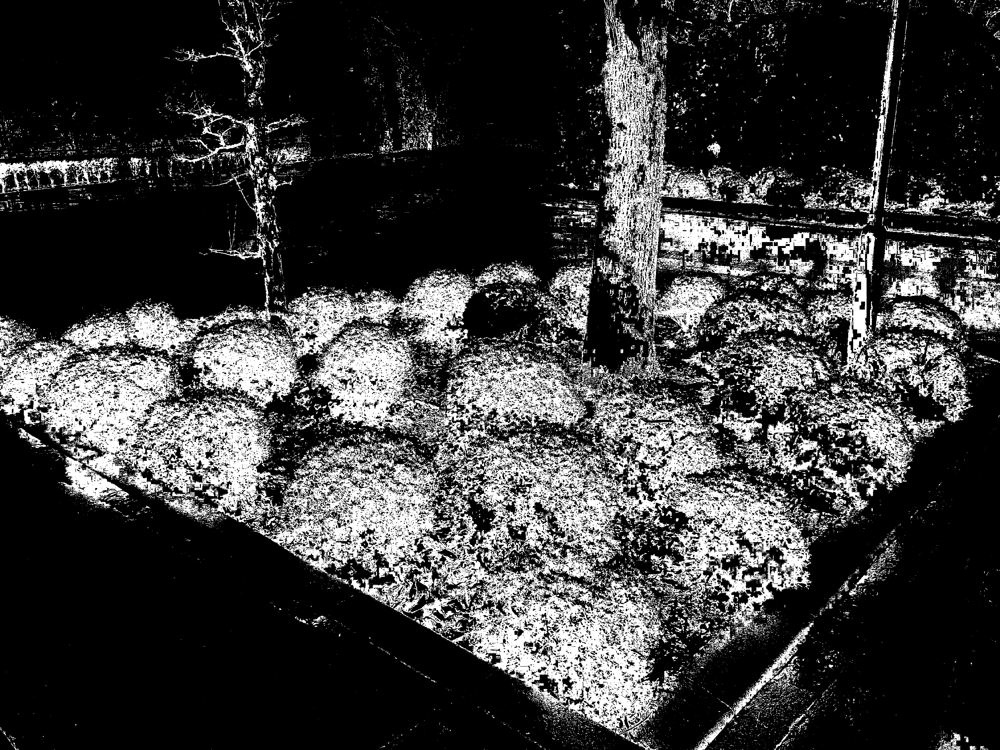

In [9]:
dst = select_pixels(img)
display_cv_image(dst)